Team Members:

Name: Hanchun Pan Student ID: 1266219, Email: hanchunp@student.unimelb.edu.au 

Name: Kaiyuan Cui Student ID: 1266180 , Email: kaicui@student.unimelb.edu.au 

Name: Runyu Yang Student ID: 1118665, Email: runyuy@student.unimelb.edu.au 

Name: Yaotian Wang  Student ID: 1503936, Email: yaotwang@student.unimelb.edu.au 

Name: Zhenghan Zhang Student ID: 1136448, Email: zhenghanz1@student.unimelb.edu.au 


## Package Import

In [2]:
from datetime import datetime, timedelta
import time
import requests
import json
import pandas as pd
import re
import ast
import folium
from folium.plugins import HeatMap
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import shape, MultiPolygon, Point, Polygon
import pyecharts.options as opts
from pyecharts.charts import Timeline, Bar, Grid, Pie, Line, Scatter
from pyecharts.globals import ThemeType
import warnings
warnings.filterwarnings('ignore')
from requests.exceptions import RequestException
requests.packages.urllib3.disable_warnings()

import numpy as np
from sklearn.cross_decomposition import PLSRegression
from sklearn.preprocessing import StandardScaler
import plotly.express as px
import seaborn as sns

## Identify Parameters

In [3]:
## Analysis Year of 2016
analysis_year = 2016
## Analysis Time Period of Real-time Data
time_period = 72

## Basic functions

In [4]:
### Functions for Read Data With RestfulAPI
def read_full(index, retries=3, wait_time=30):
    """
    Reads data from a given index URL, with retry mechanism if the request fails.

    Parameters:
    index (str): The index to append to the base URL.
    retries (int): Number of retries if the request fails.
    wait_time (int): Wait time in seconds before retrying.

    Returns:
    pd.DataFrame: DataFrame containing the requested data.
    """
    url = 'http://localhost:9090/' + index
    attempt = 0
    
    while attempt < retries:
        response = requests.get(url)
        if response.status_code == 200:
            json_data = response.json()
            df = pd.DataFrame(json_data)
            return df
        else:
            print(f"Request failed with status code: {response.status_code}. Retrying in {wait_time} seconds...")
            attempt += 1
            time.sleep(wait_time)
    
    print("All retries failed.")
    return pd.DataFrame()
        
def read_data_by_year(index, year, retries=3, wait_time=30):
    url = 'http://localhost:9090/'+ index + '/year/' + str(year)
    attempt = 0
    
    while attempt < retries:
        response = requests.get(url)
        if response.status_code == 200:
            json_data = response.json()
            df = pd.DataFrame(json_data)
            return df
        else:
            print(f"Request failed with status code: {response.status_code}. Retrying in {wait_time} seconds...")
            attempt += 1
            time.sleep(wait_time)
    
    print("All retries failed.")
    return pd.DataFrame()

def extract_real_time_data(index, time_period, retries=3, wait_time=30):
    current_time = datetime.utcnow()
    start_time = current_time - timedelta(hours=time_period)
    if index == 'bom':
        bom_url_template = "http://127.0.0.1:9090/get-bom-data?start={start_time}&end={end_time}"
        # Format the start and end times
        end_time_str = current_time.strftime('%Y%m%d%H%M%S')
        start_time_str = start_time.strftime('%Y%m%d%H%M%S')
        wrapped_url = bom_url_template.format(start_time=start_time_str, end_time=end_time_str)
    elif index == 'epa':
        epa_url_template = "http://127.0.0.1:9090/get-epa-data?start={start_time}&end={end_time}"
        end_time_str = current_time.strftime('%Y-%m-%dT%H:%M:%SZ')
        start_time_str = start_time.strftime('%Y-%m-%dT%H:%M:%SZ')
        wrapped_url = epa_url_template.format(start_time=start_time_str, end_time=end_time_str)
        
    attempt = 0
    while attempt < retries:
        response = requests.get(wrapped_url)
        if response.status_code == 200:
            json_data = response.json()
            df = pd.DataFrame(json_data)
            return df
        else:
            print(f"Request failed with status code: {response.status_code}. Retrying in {wait_time} seconds...")
            attempt += 1
            time.sleep(wait_time)
    
    print("All retries failed.")
    return pd.DataFrame()

def convert_to_shape(geo_dict):
    return shape(geo_dict)

def swap_coordinates(geometry):
    """
    Swaps the x and y coordinates of a Point geometry.
    
    Parameters:
    geometry (shapely.geometry): The geometry to swap coordinates.
    
    Returns:
    shapely.geometry: The geometry with swapped coordinates.
    """
    if geometry and geometry.geom_type == 'Point':
        return Point(geometry.y, geometry.x)
    return geometry

def safe_json_loads(json_str):
    """
    Safely loads a JSON string to a Python object.
    
    Parameters:
    json_str (str): The JSON string to load.
    
    Returns:
    dict or None: The loaded Python object, or None if loading failed.
    """
    if isinstance(json_str, str):
        try:
            return ast.literal_eval(json_str)
        except (ValueError, SyntaxError):
            return None
    return json_str

def process_geodata(geodata_df):
    """
    Processes geographical data by converting the 'geometry' column to Shapely shapes,
    converting the DataFrame to a GeoDataFrame, and renaming specified columns.

    Parameters:
    geodata_df (pd.DataFrame): DataFrame containing geographical data.

    Returns:
    gpd.GeoDataFrame: Processed GeoDataFrame.
    """
    geodata_df['geometry'] = geodata_df['geometry'].apply(convert_to_shape)
    geo_data = gpd.GeoDataFrame(geodata_df, geometry='geometry')
    geo_data = geo_data.rename(columns={
        'State_name_2021': 'state_name',
        'LGA_code_2023': 'lga_code',
        'LGA_name_2023': 'lga_name'
    })
    return geo_data

def merge_and_process_homeless_data(geo_data, homeless_df):
    """
    Merges geographical data with homelessness data on 'lga_code' and processes the merged DataFrame.

    Parameters:
    geo_data (gpd.GeoDataFrame): GeoDataFrame containing geographical data.
    homeless_df (pd.DataFrame): DataFrame containing homelessness data.

    Returns:
    pd.DataFrame: Merged and processed DataFrame.
    """
    homeless_state_df = pd.merge(geo_data, homeless_df, on='lga_code', how='inner')
    homeless_state_df['year'] = homeless_state_df['year'].astype(int)
    homeless_state_df = homeless_state_df.drop(columns='lga_name_y')
    homeless_state_df = homeless_state_df.rename(columns={
        'lga_name_x': 'lga_name'
    })
    
    return homeless_state_df

def format_data(dataframe):
    years = dataframe['year'].unique()
    formatted_data = {}
    for year in years:
        yearly_data = dataframe[dataframe['year'] == year]
        top10_data = yearly_data.nlargest(10, 'total')
        formatted_data[year] = {
            'lga_name': top10_data['lga_name'].tolist(),
            'at_risk': top10_data['at_risk'].tolist(),
            'homeless': top10_data['homeless'].tolist(),
            'not_state': top10_data['not_state'].tolist()
        }
    return formatted_data

def merge_and_analyze_crime_data(crime_df, homeless_state_df):
    """
    Merges crime data with processed homelessness data, calculates total offences, 
    and computes the correlation matrix for crime and homelessness data.

    Parameters:
    crime_df (pd.DataFrame): DataFrame containing crime data.
    homeless_state_df (pd.DataFrame): DataFrame containing processed homelessness data.

    Returns:
    pd.DataFrame: Correlation matrix for specified crime and homelessness data.
    """
    merge_crime_data = pd.merge(crime_df, homeless_state_df, on=['year', 'lga_code'], how='inner')
    offence_list = ['a_offences_num', 'b_offences_num', 'c_offences_num', 'd_offences_num', 'e_offences_num', 'f_offences_num']
    merge_crime_data['total_offences'] = merge_crime_data[offence_list].sum(axis=1)
    numeric_crime_cols = merge_crime_data.select_dtypes(include=[float, int])
    correlation_crime_matrix = numeric_crime_cols.corr()
    homeless_crime_correlation = correlation_crime_matrix.loc[['at_risk', 'homeless', 'not_state'], offence_list]
    offence_type_df = pd.DataFrame({
        'Offence Type': offence_list,
        'Number of Offences': [merge_crime_data[col].sum() for col in offence_list]
    })
    return homeless_crime_correlation, offence_type_df

def process_income_data(income_df, geo_data):
    """
    Processes income data by extracting data for a specific year, merging with geographical data,
    and preparing it for further analysis.

    Parameters:
    income_df (pd.DataFrame): DataFrame containing income data.
    geo_data (gpd.GeoDataFrame): GeoDataFrame containing geographical data.

    Returns:
    gpd.GeoDataFrame: Processed GeoDataFrame with income data.
    """
    income_data = income_df.drop(columns=['lga_name_x']).rename(columns={'lga_name_y': 'lga_name'})
    draw_income_data = pd.merge(income_data, geo_data, on='lga_code', how='inner')
    draw_income_data = draw_income_data.drop(columns=['lga_name_x']).rename(columns={'lga_name_y': 'lga_name'})
    draw_data_income = gpd.GeoDataFrame(draw_income_data, geometry='geometry')
    draw_data_income['year'] = draw_data_income['year'].astype(int)
    vic_data = draw_data_income[draw_data_income['state_name'] == 'Victoria']
    vic_df = vic_data.drop(columns='geometry')
    need_col = ['lga_code', 'lga_name', 'total']
    vic_df = vic_df[need_col]
    vic_df['geometry'] = vic_data['geometry'].centroid
    accumulated_data = gpd.GeoDataFrame(vic_df, geometry='geometry', crs=draw_data_income.crs).reset_index(drop=True)
    return vic_data, accumulated_data

def merge_and_process_population_data(draw_data_income, pop_df):
    """
    Merges income data with population data, processes the merged DataFrame by dropping and renaming columns,
    and prepares it for further analysis.

    Parameters:
    draw_data_income (gpd.GeoDataFrame): GeoDataFrame containing processed income and geographical data.
    pop_df (pd.DataFrame): DataFrame containing population data.

    Returns:
    pd.DataFrame: Processed DataFrame ready for further analysis.
    """
    pop_df = pop_df.fillna(0)
    merge_pop_data = pd.merge(draw_data_income, pop_df, on=['year', 'lga_code'], how='inner')
    merge_pop_data = merge_pop_data.drop(columns=['state_name_y']).rename(columns={'state_name_x': 'state_name'})
    merge_pop_data = merge_pop_data.drop(columns=['lga_name_y']).rename(columns={'lga_name_x': 'lga_name'})
    analysis_col = [col for col in merge_pop_data.columns if col not in ['at_risk', 'not_state', 'homeless', 'fid', 'lga_name', 'year', 'state_name', 'geometry']]
    analysis_df = merge_pop_data[analysis_col]
    analysis_df = analysis_df.fillna(0)
    return merge_pop_data, analysis_df

def process_bom_data(bom_df):
    """
    Processes Bureau of Meteorology (BOM) data by removing rows with missing temperature data,
    converting date-time format, and creating a GeoDataFrame.

    Parameters:
    bom_df (pd.DataFrame): DataFrame containing BOM data.

    Returns:
    gpd.GeoDataFrame: Processed GeoDataFrame with BOM data.
    """
    bom_df = bom_df.dropna(subset=['air_temp'])
    bom_df = bom_df.dropna(subset=['apparent_t'])
    bom_df['local_date_time_full'] = pd.to_datetime(bom_df['local_date_time_full'], format='%Y%m%d%H%M%S')
    bom_gdf = gpd.GeoDataFrame(
        bom_df,
        geometry=gpd.points_from_xy(bom_df.lon, bom_df.lat)
    )
    bom_gdf.set_crs(epsg=4326, inplace=True)
    return bom_gdf

def analyze_victoria_data(bom_gdf, homeless_state_df):
    """
    Analyzes BOM data for Victoria by spatially joining it with homeless data,
    and calculating average temperatures for each Local Government Area (LGA).

    Parameters:
    bom_gdf (gpd.GeoDataFrame): GeoDataFrame containing BOM data.
    homeless_state_df (pd.DataFrame): DataFrame containing homeless data.

    Returns:
    pd.DataFrame: DataFrame with average temperatures and homeless data for each LGA in Victoria.
    """
    vic_homeless = homeless_state_df[(homeless_state_df['state_name'] == 'Victoria') & (homeless_state_df['year'] == 2018)]
    vic_bom_data = gpd.sjoin(bom_gdf, vic_homeless, how="inner", op='within')
    vic_bom_data = vic_bom_data.groupby(['lga_name'])[['apparent_t', 'air_temp']].mean().reset_index()
    homeless_bom_data = vic_bom_data.merge(vic_homeless, on='lga_name')
    return homeless_bom_data

def get_station_data(bom_gdf):
    """
    Retrieves BOM data for the Melbourne station and sorts it by date-time.

    Parameters:
    bom_gdf (gpd.GeoDataFrame): GeoDataFrame containing BOM data.

    Returns:
    pd.DataFrame: DataFrame containing BOM data for the Melbourne station, sorted by date-time.
    """
    station_name_list = [bom for bom in bom_gdf['name'] if 'Melbourne' in bom]
    station_data = bom_gdf[bom_gdf['name'] == station_name_list[-1]]
    sorted_station_data = station_data.sort_values(by='local_date_time_full')
    return sorted_station_data

def extract_time_series_with_siteID(data):
    """
    Extracts time series data with site ID from the given data.
    
    Parameters:
    data (pd.DataFrame): The DataFrame containing the time series data.
    
    Returns:
    pd.DataFrame: A DataFrame with extracted time series data.
    """
    records = []
    for idx, row in data.iterrows():
        for ts in row['timeSeriesReadings']:
            for reading in ts['readings']:
                records.append({
                    'siteID': row['siteID'],
                    'name': row['name'],
                    'since': pd.to_datetime(reading.get('since')),
                    'until': pd.to_datetime(reading.get('until')),
                    'averageValue': reading.get('averageValue', None)
                })
    return pd.DataFrame(records)

def process_epa_data(epa_df):
    """
    Processes EPA data by converting geometries, extracting time series data, 
    and merging with the main GeoDataFrame.
    
    Parameters:
    epa_df (pd.DataFrame): The DataFrame containing EPA data.
    
    Returns:
    gpd.GeoDataFrame: The processed GeoDataFrame with EPA data.
    """
    epa_data = epa_df['_source'].to_list()
    epa_data = pd.DataFrame(epa_data)

    epa_data['geometry'] = epa_data['geometry'].apply(convert_to_shape)
    epa_data['geometry'] = epa_data['geometry'].apply(swap_coordinates)
    epa_gdf = gpd.GeoDataFrame(epa_data, geometry='geometry')

    epa_gdf['parameters'] = epa_gdf['parameters'].apply(safe_json_loads)
    parameters = epa_gdf.explode('parameters').reset_index(drop=True)
    parameters_expanded = pd.json_normalize(parameters['parameters'].dropna())
    parameters_expanded['siteID'] = parameters['siteID']

    df_extracted = extract_time_series_with_siteID(parameters_expanded)
    merged_epa = epa_gdf.merge(df_extracted, on='siteID')

    return merged_epa

def analyze_victoria_epa_data(epa_df, homeless_state_df):
    """
    Analyzes EPA data for Victoria by spatially joining it with homeless data,
    calculating average PM2.5 values for each Local Government Area (LGA).

    Parameters:
    merged_epa (gpd.GeoDataFrame): The processed GeoDataFrame with merged EPA data.
    homeless_state_df (pd.DataFrame): DataFrame containing homeless data.

    Returns:
    pd.DataFrame: DataFrame with average PM2.5 values and homeless data for each LGA in Victoria.
    """
    merged_epa = process_epa_data(epa_df)
    analysis_col = ['siteName', 'siteType', 'since', 'until', 'averageValue', 'name', 'geometry']
    analysis_data = merged_epa[analysis_col]
    analysis_data = analysis_data.dropna(subset=['averageValue'])

    # Spatially join EPA data with Victoria homeless data
    vic_homeless = homeless_state_df[(homeless_state_df['state_name'] == 'Victoria') & (homeless_state_df['year'] == 2018)]
    pm25_vic = gpd.sjoin(analysis_data, vic_homeless, how="inner", op='within')

    # Calculate the mean PM2.5 values for each LGA
    vic_pm25_data = pm25_vic.groupby(['lga_name', 'name'])['averageValue'].mean().reset_index()

    # Filter the data for PM2.5
    homeless_epa_data = vic_pm25_data.merge(vic_homeless, on='lga_name')
    pm25_data = homeless_epa_data[homeless_epa_data['name'] == 'PM2.5']
    
    return pm25_data


## Data Request During RestfulAPI

### Geodata Load and Process

In [6]:
geodata = pd.DataFrame()
index_list = [100, 200, 300, 400, 500, 547]
for i in range(len(index_list)):
    if i == 0:
        limit = index_list[i]
    else:
        limit = index_list[i] - index_list[i-1]
    url = f'get-geodata?from-last={index_list[i]}&limit={limit}'
    data = read_full(url)
    geodata = pd.concat([data, geodata],axis=0, ignore_index=True).reset_index(drop=True)
geodata_df = process_geodata(geodata)

Request failed with status code: 500. Retrying in 30 seconds...
Request failed with status code: 500. Retrying in 30 seconds...
Request failed with status code: 500. Retrying in 30 seconds...


### Homeless Data Load and Process

In [7]:
homelss_data = read_full('get-homeless-data')
homeless_geodata = merge_and_process_homeless_data(geodata_df, homelss_data)

### Crime Data Load and Process

In [8]:
crime_data = read_full('get-crime-data')
homeless_crime_correlation, offence_data = merge_and_analyze_crime_data(crime_data, homeless_geodata)

### Income Data Load and Process

In [9]:
income_df = read_data_by_year('get-income-data', analysis_year)
income_vic_geodata, homeless_point_df = process_income_data(income_df, geodata_df)

### Population Data Load and Process

In [10]:
pop_df = read_full('get-pop-data')
pop_homeless_income_df, analysis_df = merge_and_process_population_data(income_vic_geodata, pop_df)

### BoM Data Load and Process

In [11]:
bom_df= extract_real_time_data('bom', time_period)
bom_gdf = process_bom_data(bom_df)
station_data = get_station_data(bom_gdf)
homeless_bom_data = analyze_victoria_data(bom_gdf, homeless_geodata)

Request failed with status code: 500. Retrying in 30 seconds...


### EPA Data Load and Process

In [12]:
epa_df = extract_real_time_data('epa', time_period)
epa_pm25_df = analyze_victoria_epa_data(epa_df, homeless_geodata)

Request failed with status code: 500. Retrying in 30 seconds...


## Overall Homeless Data Analysis

### State Homeless Data Analysis

In [13]:
state_total = homeless_geodata.groupby('state_name')['total'].sum().reset_index()
state_categories = homeless_geodata.groupby('state_name')[['at_risk', 'homeless', 'not_state']].sum().reset_index()

states = state_total['state_name'].tolist()
total_values = state_total['total'].tolist()
at_risk_values = state_categories['at_risk'].tolist()
homeless_values = state_categories['homeless'].tolist()
not_state_values = state_categories['not_state'].tolist()

bar = (
    Bar(init_opts=opts.InitOpts(theme=ThemeType.LIGHT))
    .add_xaxis(states)
    .add_yaxis("At Risk", at_risk_values, stack="stack1", category_gap="50%", label_opts=opts.LabelOpts(is_show=False))
    .add_yaxis("Homeless", homeless_values, stack="stack1", category_gap="50%", label_opts=opts.LabelOpts(is_show=False))
    .add_yaxis("Not State", not_state_values, stack="stack1", category_gap="50%", label_opts=opts.LabelOpts(is_show=False))
    .extend_axis(
        yaxis=opts.AxisOpts(
            name="Total",
            type_="value",
            min_=0,
            max_=max(total_values) * 1.2,
            interval=max(total_values) / 5,
            axislabel_opts=opts.LabelOpts(formatter="{value}"),
        )
    )
    .set_global_opts(
        title_opts=opts.TitleOpts(title="Total and Categories by State"),
        tooltip_opts=opts.TooltipOpts(trigger="axis", axis_pointer_type="shadow"),
        xaxis_opts=opts.AxisOpts(type_="category"),
        yaxis_opts=opts.AxisOpts(
            type_="value",
            name="Counts",
            axislabel_opts=opts.LabelOpts(formatter="{value}", font_size=10),
        ),
    )
)

# Create a line chart
line = (
    Line()
    .add_xaxis(states)
    .add_yaxis(
        "Total", 
        total_values, 
        yaxis_index=1, 
        label_opts=opts.LabelOpts(is_show=False)
    )
)

# Combine bar and line charts
bar.overlap(line).render_notebook()

### Victoria Homeless Data Analysis

In [14]:
victoria_data = homeless_geodata[homeless_geodata['state_name'] == 'Victoria'].sort_values(by='year')
formatted_data = format_data(victoria_data)
def get_year_overlap_chart(year):
    bar = (
        Bar()
        .add_xaxis(xaxis_data=formatted_data[year]['lga_name'])
        .add_yaxis(
            series_name="At Risk",
            y_axis=formatted_data[year]['at_risk'],
            label_opts=opts.LabelOpts(is_show=False),
        )
        .add_yaxis(
            series_name="Homeless",
            y_axis=formatted_data[year]['homeless'],
            label_opts=opts.LabelOpts(is_show=False),
        )
        .add_yaxis(
            series_name="Not State",
            y_axis=formatted_data[year]['not_state'],
            label_opts=opts.LabelOpts(is_show=False),
        )
        .set_global_opts(
            title_opts=opts.TitleOpts(
                title="{} Homelessness Data".format(year), subtitle="Data by LGA"
            ),
            tooltip_opts=opts.TooltipOpts(
                is_show=True, trigger="axis", axis_pointer_type="shadow"
            ),
            legend_opts=opts.LegendOpts(
                selected_map={
                    "At Risk": True,
                    "Homeless": True,
                    "Not State": True,
                }
            ),
            xaxis_opts=opts.AxisOpts(
                axislabel_opts=opts.LabelOpts(rotate=10, font_size=10)
            )
        )
    )
    pie = (
        Pie()
        .add(
            series_name="Homelessness Breakdown",
            data_pair=[
                ["At Risk", sum(formatted_data[year]['at_risk'])],
                ["Homeless", sum(formatted_data[year]['homeless'])],
                ["Not State", sum(formatted_data[year]['not_state'])],
            ],
            center=["75%", "35%"],
            radius="28%",
        )
        .set_series_opts(tooltip_opts=opts.TooltipOpts(is_show=True, trigger="item"))
    )
    return bar.overlap(pie)

timeline = Timeline(init_opts=opts.InitOpts(
    theme=ThemeType.LIGHT,
    width="1200px",
    height="800px"
))

for y in formatted_data.keys():
    timeline.add(get_year_overlap_chart(year=y), time_point=str(y))

timeline.add_schema(is_auto_play=True, play_interval=2500)
timeline.render_notebook()

## Scenario1: Victoria Income, Population and Homeless Analysis

### Map of Income Data and Homeless Data

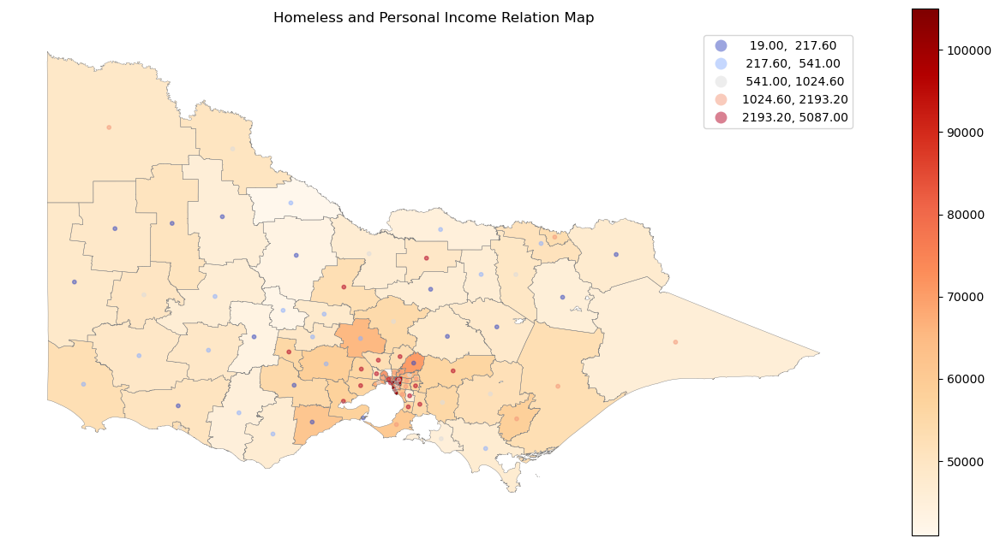

In [15]:
fig, ax = plt.subplots(figsize=(16, 8))
income_vic_geodata.plot(ax=ax, column='mean_aud', cmap='OrRd', alpha=1, legend=True)
homeless_data = homeless_point_df.plot(ax=ax, column='total', cmap='coolwarm', scheme='quantiles', alpha=0.5, markersize=10, legend=True)
income_vic_geodata.boundary.plot(ax=ax, linewidth=0.3, edgecolor='grey')

ax.axis('off')

# Title for the plot
ax.set_title('Homeless and Personal Income Relation Map')

# Create legends manually if not created automatically
handles, labels = ax.get_legend_handles_labels()
if handles:
    leg = ax.legend(handles, labels, title='Homeless people num')
    for lbl in leg.get_texts():
        label_text = lbl.get_text()
        label_parts = label_text.split(', ')
        new_text = f'{float(label_parts[0]):,.0f} - {float(label_parts[1]):,.0f}'
        lbl.set_text(new_text)

plt.show()

### Map of Income, population and homeless

In [16]:
pop_homeless_income_df['center'] = pop_homeless_income_df['geometry'].centroid
pop_homeless_income_df['center_lat'] = pop_homeless_income_df['center'].y
pop_homeless_income_df['center_lon'] = pop_homeless_income_df['center'].x
victoria_map_data = pop_homeless_income_df[pop_homeless_income_df['state_name'] == 'Victoria']
if victoria_map_data.crs is None:
    victoria_map_data = victoria_map_data.set_crs(epsg=4326)
geojson_data = victoria_map_data[['geometry', 'lga_name']].to_json() 
m = folium.Map(location=[-37.8136, 144.9631], zoom_start=9)

def highlight_feature(feature):
    return {
        'fillColor': '#ffaf00',
        'color': 'orange',
        'weight': 1.5,
        'dashArray': '3',
        'fillOpacity': 0.7,
    }

# Add Mean_AUD Choropleth Layer
folium.Choropleth(
    geo_data=geojson_data,
    data=victoria_map_data,
    columns=['lga_name', 'mean_aud'],
    key_on='feature.properties.lga_name',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Mean Income (AUD)'
).add_to(m)

for _, row in victoria_map_data.iterrows():
    geojson = folium.GeoJson(
        row['geometry'],
        style_function=lambda feature: {
            'color': 'orange',
            'weight': 1,  
            'fillOpacity': 0.001,
            'fillColor': 'orange',
        },
        highlight_function=highlight_feature,
        tooltip=folium.Tooltip(row['lga_name'])
    )
    geojson.add_to(m)

# Add Population and Homeless Number Circle Markers
for _, row in victoria_map_data.iterrows():
    popup_content = f"""
    <div style="width:200px;">
    <b>LGA Name:</b> {row['lga_name']}<br>
    <b>ERP Population:</b> {row['erp']}<br>
    <b>Homeless Num:</b> {row['total']}
    </div>
    """
    popup = folium.Popup(popup_content, max_width=150)
    folium.CircleMarker(
        location=[row['center_lat'], row['center_lon']],
        # Ratio of a standardised value of population erp (per 25 people) to the total number of homeless in LGA
        radius=(row['erp']/25) /row['total'],
        color='Red',
        popup=popup,
        fill=True,
        fill_color='Red',
        fill_opacity=0.6
    ).add_to(m)
m

### Income, homeless, population PLS Analysis

In [17]:
X = analysis_df.drop(columns=['total'])
y = analysis_df['total'].values
pls = PLSRegression(n_components=2)

scaler_X = StandardScaler()
scaler_y = StandardScaler()

X_scaled = scaler_X.fit_transform(X)
y_scaled = scaler_y.fit_transform(y.reshape(-1, 1)).flatten()

# PLS Regression Analysis
pls = PLSRegression(n_components=2)
pls.fit(X_scaled, y_scaled)
X_scores = pls.x_scores_

x_scores = pls.x_scores_
y_scores = pls.y_scores_

correlations = pd.DataFrame({
        'Feature': X.columns,
        'Component 1': pls.x_weights_[:, 0],
        'Component 2': pls.x_weights_[:, 1]
    })
correlations = correlations.sort_values(by='Component 1', ascending=False)

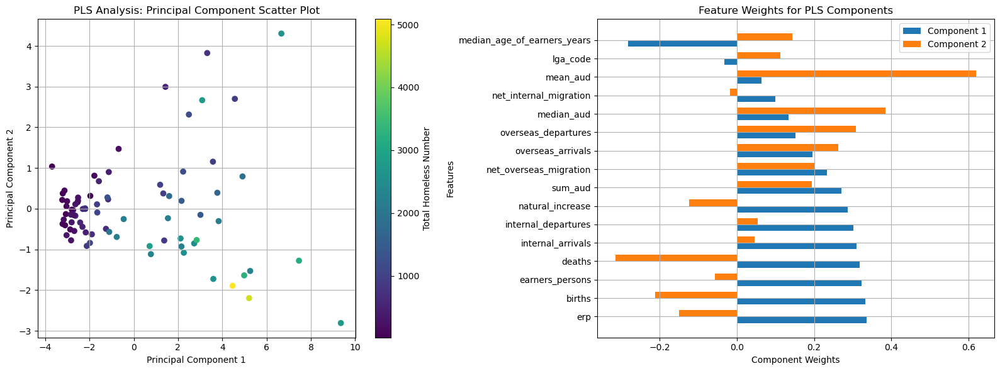

In [18]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))
scatter = ax1.scatter(x_scores[:, 0], x_scores[:, 1], c=y, cmap='viridis')
cbar = plt.colorbar(scatter, ax=ax1)
cbar.set_label('Total Homeless Number')
ax1.set_xlabel('Principal Component 1')
ax1.set_ylabel('Principal Component 2')
ax1.set_title('PLS Analysis: Principal Component Scatter Plot')
ax1.grid(True)

bar_width = 0.35
index = np.arange(len(correlations))
ax2.barh(index - bar_width / 2, correlations['Component 1'], bar_width, label='Component 1')
ax2.barh(index + bar_width / 2, correlations['Component 2'], bar_width, label='Component 2')
ax2.set_xlabel('Component Weights')
ax2.set_ylabel('Features')
ax2.set_title('Feature Weights for PLS Components')
ax2.set_yticks(index)
ax2.set_yticklabels(correlations['Feature'])
ax2.legend()
ax2.grid(True)

plt.tight_layout()

## Scenario2: Real-Time Data and Homeless Analysis

### BoM data Monitor

In [19]:
timeData = station_data['local_date_time_full'].astype(str).tolist()
air_temp = station_data['air_temp'].tolist()
apparent_t = station_data['apparent_t'].tolist()

l1 = (
    Line()
    .add_xaxis(xaxis_data=timeData)
    .add_yaxis(
        series_name="air_temp",
        y_axis=air_temp,
        symbol_size=8,
        is_hover_animation=False,
        label_opts=opts.LabelOpts(is_show=False),
        linestyle_opts=opts.LineStyleOpts(width=1.5),
        is_smooth=True,
    )
    .set_global_opts(
        title_opts=opts.TitleOpts(
            title="Air temperature and Apparent Temperature Monitor", subtitle="Station Data of Melbourne (Olympic Park)", pos_left="center"
        ),
        axispointer_opts=opts.AxisPointerOpts(
            is_show=True, link=[{"xAxisIndex": "all"}]
        ),
        tooltip_opts=opts.TooltipOpts(trigger="axis"),
        xaxis_opts=opts.AxisOpts(
            type_="category",
            boundary_gap=False,
            axisline_opts=opts.AxisLineOpts(is_on_zero=True),
        ),
        datazoom_opts=[
            opts.DataZoomOpts(
                is_realtime=True,
                type_="inside",
                start_value=30,
                end_value=70,
                xaxis_index=[0, 1],
            )
        ],
        yaxis_opts=opts.AxisOpts(name="Air Temperature(°C)"),
        legend_opts=opts.LegendOpts(pos_left="left"),
    )
)

l2 = (
    Line()
    .add_xaxis(xaxis_data=timeData)
    .add_yaxis(
        series_name="apparent_t",
        y_axis=apparent_t,
        symbol_size=8,
        is_hover_animation=False,
        label_opts=opts.LabelOpts(is_show=False),
        linestyle_opts=opts.LineStyleOpts(width=1.5),
        is_smooth=True,
    )
    .set_global_opts(
        axispointer_opts=opts.AxisPointerOpts(
            is_show=True, link=[{"xAxisIndex": "all"}]
        ),
        tooltip_opts=opts.TooltipOpts(trigger="axis"),
        xaxis_opts=opts.AxisOpts(
            grid_index=1,
            type_="category",
            boundary_gap=False,
            axisline_opts=opts.AxisLineOpts(is_on_zero=True),
            position="top",
        ),
        datazoom_opts=[
            opts.DataZoomOpts(
                is_realtime=True,
                type_="inside",
                start_value=30,
                end_value=70,
                xaxis_index=[0, 1],
            )
        ],
        yaxis_opts=opts.AxisOpts(is_inverse=True, name="Apparent Temperature(°C)"),
        legend_opts=opts.LegendOpts(pos_left="10%"),
    )
)

grid = (
    Grid(init_opts=opts.InitOpts(width="1024px", height="768px"))
    .add(chart=l1, grid_opts=opts.GridOpts(pos_left=60, pos_right=50, height="35%"))
    .add(
        chart=l2,
        grid_opts=opts.GridOpts(pos_left=60, pos_right=50, pos_top="55%", height="35%"),
    )
    .render_notebook()
)
grid

### Analysis of BoM and Homeless Data

In [20]:
x_data = homeless_bom_data['lga_name'].astype(str).tolist()
at_risk_num = homeless_bom_data['at_risk'].tolist()
homeless_num = homeless_bom_data['homeless'].tolist()
not_state_num = homeless_bom_data['not_state'].tolist()
apparent_t = [round(num, 2) for num in homeless_bom_data['apparent_t'].tolist()]
colors = ["#5793f3", "#d14a61", "#675bba"]
bar = (
    Bar(init_opts=opts.InitOpts(width="1260px", height="720px", theme=ThemeType.LIGHT))
    .add_xaxis(x_data)
    .add_yaxis("At Risk", at_risk_num, yaxis_index=0, color=colors[2], label_opts=opts.LabelOpts(is_show=False))
    .add_yaxis("Homeless", homeless_num, yaxis_index=0, color=colors[1], label_opts=opts.LabelOpts(is_show=False))
    .add_yaxis("Not State", not_state_num, yaxis_index=0, color=colors[0], label_opts=opts.LabelOpts(is_show=False))
    .extend_axis(
        yaxis=opts.AxisOpts(
            name="Apparent Temperature (°C)",
            type_="value",
            min_=0,
            position="right",
            offset=0,
            axisline_opts=opts.AxisLineOpts(
                linestyle_opts=opts.LineStyleOpts(color="#ff733f")
            ),
            axislabel_opts=opts.LabelOpts(formatter="{value} °C"),
        )
    )
    .set_global_opts(
        title_opts=opts.TitleOpts(title="Homeless and Temperature Data"),
        tooltip_opts=opts.TooltipOpts(trigger="axis", axis_pointer_type="cross"),
        yaxis_opts=opts.AxisOpts(
            name="Count",
            type_="value",
            position="left",
            axisline_opts=opts.AxisLineOpts(
                linestyle_opts=opts.LineStyleOpts(color=colors[2])
            ),
            axislabel_opts=opts.LabelOpts(formatter="{value}"),
        ),
    )
)

# Creating line charts and overlaying them on bar charts
line = (
    Line()
    .add_xaxis(x_data)
    .add_yaxis("Apparent Temperature", apparent_t, yaxis_index=1, color="#ff733f")
)

bar.overlap(line)
bar.render_notebook()

### Analysis of EPA and Homeless Data

In [21]:
fig = px.scatter(
    epa_pm25_df,
    x="averageValue",
    y="total",
    size="total",
    color="lga_name",
    hover_name="lga_name",
    size_max=60,
    title="Total vs Average Value",
    labels={"averageValue": "Average Value", "total": "Total"}
)

fig.update_layout(
    xaxis_title="Average PM2.5 Value",
    yaxis_title="Total Homeless Num",
    title_x=0.5,
)

fig.show()

## Scenario3: Correlation between Homeless Data and Crime Data

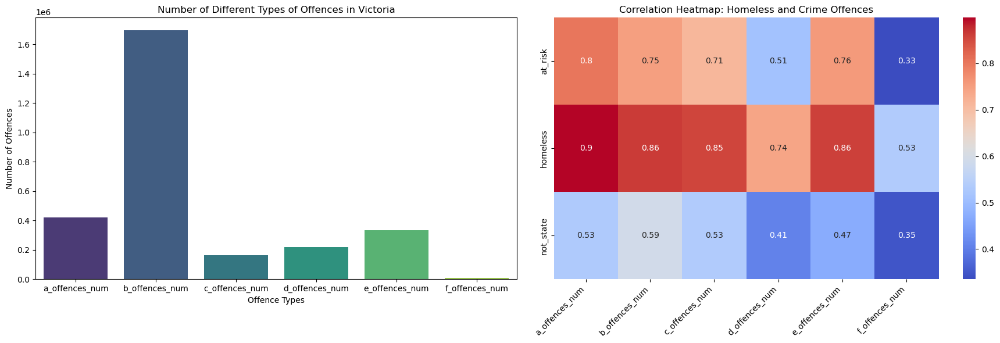

In [22]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(18, 6))

sns.barplot(x='Offence Type', y='Number of Offences', data=offence_data, palette='viridis', ax=ax1)
ax1.set_title('Number of Different Types of Offences in Victoria')
ax1.set_xlabel('Offence Types')
ax1.set_ylabel('Number of Offences')

sns.heatmap(homeless_crime_correlation, annot=True, cmap='coolwarm', cbar=True, ax=ax2)
ax2.set_title('Correlation Heatmap: Homeless and Crime Offences')
ax2.set_xticklabels(ax2.get_xticklabels(), rotation=45, ha='right')

plt.tight_layout()
plt.show()